# Import the Library 

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import gymnasium as gym
import yfinance as yf
from gymnasium import spaces
from stable_baselines3 import A2C,PPO,SAC,TD3,DDPG
from stable_baselines3.common.vec_env import DummyVecEnv
from stable_baselines3.common.callbacks import BaseCallback
import pickle

# Downloading the dataset

In [ ]:
# # List of stocks in the Dow Jones 30
# tickers = [
#     'MMM', 'AXP', 'AAPL', 'BA', 'CAT', 'CVX', 'CSCO', 'KO', 'DIS', 'DOW',
#     'GS', 'HD', 'IBM', 'INTC', 'JNJ', 'JPM', 'MCD', 'MRK', 'MSFT', 'NKE',
#     'PFE', 'PG', 'TRV', 'UNH', 'UTX', 'VZ', 'V', 'WBA', 'WMT', 'XOM'
# ]
# tickers.remove('DOW')
# tickers.remove('UTX')

# # Get historical data from Yahoo Finance and save it to dictionary
# def fetch_stock_data(tickers, start_date, end_date):
#     stock_data = {}
#     for ticker in tickers:
#         stock_data[ticker] = yf.download(ticker, start=start_date, end=end_date)
#     return stock_data

# # Call the function to get data
# stock_data = fetch_stock_data(tickers, '2009-01-01', '2020-05-08')

In [2]:
with open('foreign_data.pkl', 'rb') as f:
    temp_data = pickle.load(f)

In [3]:
temp_data['AAPL']

Price,Close,High,Low,Open,Volume
Ticker,AAPL,AAPL,AAPL,AAPL,AAPL
Date,,,,,
2009-01-02,2.730994,2.739721,2.562771,2.584438,746015200
2009-01-05,2.846252,2.894402,2.789977,2.803821,1181608400
2009-01-06,2.799307,2.924195,2.780348,2.887481,1289310400
2009-01-07,2.738818,2.783657,2.716247,2.762893,753048800
2009-01-08,2.789676,2.803219,2.709627,2.721364,673500800
...,...,...,...,...,...
2022-12-23,130.344498,130.898059,128.150012,129.415299,63814900
2022-12-27,128.535522,129.899667,127.240581,129.870013,69007800


In [4]:
nifty_stock_data = temp_data.copy()


#### Train&Test Split

Training Dataset for AAPL: (1762, 5)
Validation Dataset for AAPL: (252, 5)
Test Dataset for AAPL: (1509, 5)


Price,Close,High,Low,Open,Volume
Ticker,AAPL,AAPL,AAPL,AAPL,AAPL
Date,,,,,
2009-01-02,2.730994,2.739721,2.562771,2.584438,746015200
2009-01-05,2.846252,2.894402,2.789977,2.803821,1181608400
2009-01-06,2.799307,2.924195,2.780348,2.887481,1289310400
2009-01-07,2.738818,2.783657,2.716247,2.762893,753048800
2009-01-08,2.789676,2.803219,2.709627,2.721364,673500800


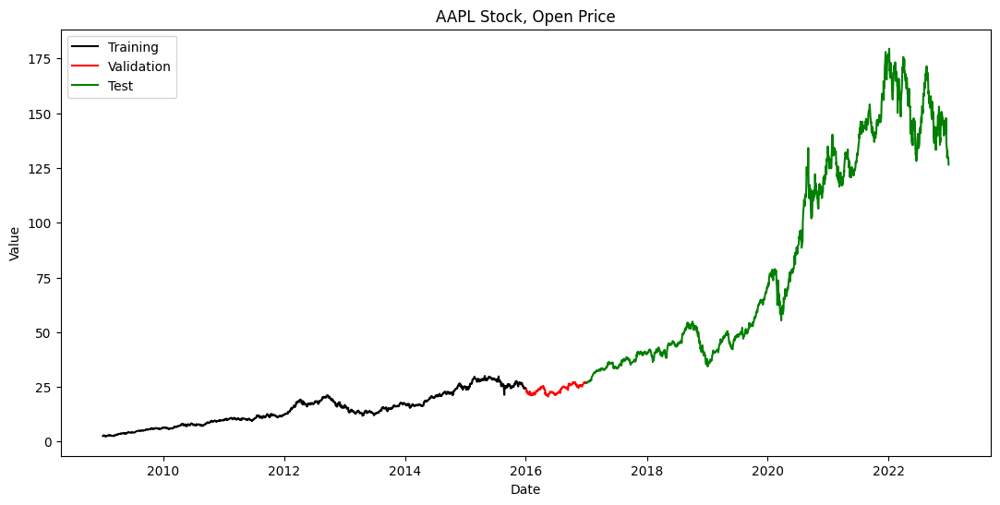

In [5]:
training_range = ('2009-01-01', '2015-12-31')
validation_range = ('2016-01-01','2016-12-31')
test_range = ('2017-01-01', '2022-12-29')

training_set = {}
validation_set = {}
test_set = {}

for ticker,df in nifty_stock_data.items():
    training_set[ticker] = df.loc[training_range[0]:training_range[1]]
    validation_set[ticker] = df.loc[validation_range[0]:validation_range[1]]
    test_set[ticker] = df.loc[test_range[0]:test_range[1]]
    
    
#Print the shape of training,test,validation split for a company
ticker = 'AAPL'
print(f'Training Dataset for {ticker}: {training_set[ticker].shape}')
print(f'Validation Dataset for {ticker}: {validation_set[ticker].shape}')
print(f'Test Dataset for {ticker}: {test_set[ticker].shape}')

#Show First 5 Rows of stock data for a company
display(nifty_stock_data['AAPL'].head())

#Plot a graph 
plt.figure(figsize=(13,6))
plt.plot(training_set[ticker].index, training_set[ticker]['Open'], label='Training', color='black')
plt.plot(validation_set[ticker].index, validation_set[ticker]['Open'], label='Validation', color='red' )
plt.plot(test_set[ticker].index, test_set[ticker]['Open'], label='Test', color='green')
plt.xlabel('Date')
plt.ylabel('Value')
plt.title(f'{ticker} Stock, Open Price')
plt.legend()
plt.show()

### Enhancing our dataset using technical indicators
  ###### MACD:- Moving Average Convergence& Divergence[Helps in indentifying potential buy or sell signals]
  ###### RSI:- Relative Strength Index[Its a momentum indicator used in technical analysis to measure the speed and change of price movements]
  ###### CGI:- Commodity Channel Index[Is a momentum based technical indicator that identifies overbought or oversold conditions and potential trend reversals]
  ###### ADX:- Average Directional Index[It measures the strength of trends, It helps traders determine whether an asset is in a strong uptrend,downtrend or moving sideways ]

In [6]:
def technical_indicators(df):
    df = df.copy()
    
    #******Calculate MACD******#
    df["EMA_12"] = df['Close'].ewm(span=12,adjust=False).mean()
    df["EMA_26"] = df['Close'].ewm(span=26, adjust=False).mean()
    
    #MACD = EMA12-EMA26
    df['MACD'] = df['EMA_12'] - df['EMA_26']
    
    #Signal Line smooths the MACD line for better trend confirmation
    df['Signal'] = df['MACD'].ewm(span=9, adjust=False).mean()
    
    #******Calculate RSI******#
    df['change'] = df['Close'].diff()
    ##Calculate profit&loss
    df['Profit'] = df['change'].apply(lambda x:x if x>0 else 0)
    df['Loss'] = df['change'].apply(lambda x:-x if x<0 else 0)
    ##Calculate AvgProfit & AvgLoss
    df['AvgProfit'] = df['Profit'].rolling(window = 14, min_periods=14).mean()
    df['AvgLoss'] = df['Loss'].rolling(window=14, min_periods = 14).mean()
    ## RS = avgProfit/avgLOSS,  RSI = 100 - (100/1+RS)
    df['rs'] = df['AvgProfit']/df["AvgLoss"]
    df['RSI_14'] = 100 - (100/1+df['rs'])
    
    #*****Calculate CCI*****#
    tp = (df['High']+df['Low']+df['Close'])/3 #Typical PRICE
    sma_tp = tp.rolling(window = 20).mean()   #Simple Moving Average
    mad = tp.rolling(window=20).apply(lambda x: (abs(x-x.mean())).mean()) #Mean Absolute Deviation
    ## CCI = (tp - sma_tp)/0.015*mad
    df['CCI_20'] = (tp-sma_tp)/0.015*mad
    
    
    #*****ADX*****#
    high_diff = df['High'].diff()
    low_diff = df['Low'].diff()
    
    #+Directional Movement = Current High - Previous High
    #-Directional Movement = Previous Low - Current Low
    df['+DM'] = np.where((high_diff>low_diff) & (high_diff>0), high_diff,0)
    df['-DM'] = np.where((low_diff>high_diff) & (low_diff>0), low_diff,0)
    
    #TrueRange = max(High-Low,abs(High-PrevClose), abs(Low-PrevClose))
    tr = pd.concat([df['High']-df['Low'], np.abs(df['High'] - df['Close'].shift(1)), np.abs(df['Low'] - df['Close'].shift(1)) ], axis=1).max(axis=1)
    atr = tr.ewm(span=14, adjust=False).mean()
    
    df['+DI'] = 100*(df['+DM'].ewm(span=14,adjust=False).mean()/atr)
    df['-DI'] = 100*(df['-DM'].ewm(span=14, adjust=False).mean()/atr)
    
    #Directional Index = (|+Directional Indicators - -Directional Indicators|/+Directional Indicators + -Directional Indicators)*100
    dx = 100*np.abs(df['+DI'] - df['-DI'])/(df['+DI'] + df['-DI'])
    
    #ADX = Avg DX over N periods
    df['ADX_14'] = dx.ewm(span = 14, adjust=False).mean()
    
    #****Discard None Values****#
    df.dropna(inplace=True)
    
    # *****Keeping the important columns only and discarding the rest***** #
    df = df[['Open', 'High', 'Low', 'Close', 'Volume', 'MACD', 'Signal', 'RSI_14', 'CCI_20', 'ADX_14']]
    
    return df

##### Adding technical indicators to our dataset

In [7]:

#****Adding to training data****#
for ticker,df in training_set.items():
    training_set[ticker] = technical_indicators(df)

#****Adding to validation data****#    
for ticker,df in validation_set.items():
    validation_set[ticker] = technical_indicators(df)

#****Adding to test data****#
for ticker,df in test_set.items():
    test_set[ticker] = technical_indicators(df)    



In [8]:
display(test_set['AAPL'])

Price,Open,High,Low,Close,Volume,MACD,Signal,RSI_14,CCI_20,ADX_14
Ticker,AAPL,AAPL,AAPL,AAPL,AAPL,,,,,
Date,,,,,,,,,,
2017-01-31,28.018796,28.074301,27.896221,28.065050,196804000,0.296701,0.262317,-2.365892,8.357751,22.666948
2017-02-01,29.378679,30.178887,29.374055,29.776470,447940000,0.424278,0.294709,-6.487870,50.633672,29.506453
2017-02-02,29.598394,29.924489,29.552138,29.725594,134841600,0.515337,0.338834,-7.823718,57.105291,33.851388
2017-02-03,29.674717,29.878239,29.640027,29.852798,98029200,0.590955,0.389258,-9.730642,63.362654,36.808662
2017-02-06,29.864349,30.181193,29.811154,30.132624,107383600,0.665787,0.444564,-9.947984,80.841196,40.130798
...,...,...,...,...,...,...,...,...,...,...
2022-12-22,132.805880,133.013458,128.802425,130.710236,77852100,-3.407984,-2.245328,-0.343998,-2714.496201,37.591322
2022-12-23,129.415299,130.898059,128.150012,130.344498,63814900,-3.612788,-2.518820,-0.356144,-3044.117226,41.076428


In [9]:
display(nifty_stock_data['AAPL'])

Price,Close,High,Low,Open,Volume
Ticker,AAPL,AAPL,AAPL,AAPL,AAPL
Date,,,,,
2009-01-02,2.730994,2.739721,2.562771,2.584438,746015200
2009-01-05,2.846252,2.894402,2.789977,2.803821,1181608400
2009-01-06,2.799307,2.924195,2.780348,2.887481,1289310400
2009-01-07,2.738818,2.783657,2.716247,2.762893,753048800
2009-01-08,2.789676,2.803219,2.709627,2.721364,673500800
...,...,...,...,...,...
2022-12-23,130.344498,130.898059,128.150012,129.415299,63814900
2022-12-27,128.535522,129.899667,127.240581,129.870013,69007800


## Making a custom trading environment for our model

In [10]:
for ticker,df in validation_set.items():
    df.columns = [col[0] for col in df.columns]

In [11]:
for ticker,df in test_set.items():
    df.columns = [col[0] for col in df.columns]

In [12]:
for ticker, df in training_set.items():
    df.columns = [col[0] for col in df.columns]

In [13]:
print(training_set['CAT'].columns)

Index(['Open', 'High', 'Low', 'Close', 'Volume', 'MACD', 'Signal', 'RSI_14',
       'CCI_20', 'ADX_14'],
      dtype='object')


In [14]:
class TradingEnv(gym.Env):
    def __init__(self,stock_data,transaction_cost_percent =0.006 ):
        super(TradingEnv,self).__init__()
        
        #This funtion is used for initializing the environment and assigning the necessary values
        
        #Remove the Empty DataFrames
        self.stock_data = {ticker:df for ticker,df in stock_data.items() if not df.empty}
        self.tickers = list(self.stock_data.keys())
        
        if not self.tickers:
            raise ValueError("Stock data is  NULL")

        #Calculate the size of one company's stock data
        sample_df = next(iter(self.stock_data.values()))
        self.n_features = len(sample_df.columns)  #Number of features of each stock{Eg:- Open,Close,Volume etc}
        
        #Define ActionSpace{ContinuousSpace in which an agent will decide the proportion of portfolio to buy/sell for each stock}
        
        #Shape will be (29,0) as 29 keys/companies are present in the dataset 
        self.action_space = spaces.Box(low=-1, high=1, shape=(len(self.tickers),), dtype=np.float32) 
        
        # Define ObservationSpace{price data for each stock+ Balance + NetWorth + Shares Held  + Max Net Worth + Current Step}
        # - 2 = Balance + NetWorth{As each are single scalar values}
        # - 2 = MaxNet Worth + Current Step{As both are also single scalar values}
        # - price_data_each_stock is the total number of price related features for each stock
        price_data_each_stock = self.n_features*len(self.tickers)
        self.obs_shape = price_data_each_stock + 2 + len(self.tickers) + 2  
        self.observation_space = spaces.Box(low= -np.inf, high= np.inf, shape=(self.obs_shape,), dtype=np.float32)
        
        #Initialize Account Balance
        self.initial_bal = 1300
        self.balance = self.initial_bal
        self.net_worth = self.initial_bal
        self.max_net_worth = self.initial_bal
        self.shares_held = {ticker: 0 for ticker in self.tickers}
        self.total_shares_sold = {ticker: 0 for ticker in self.tickers}
        self.total_shares_val = {ticker: 0  for ticker in self.tickers}
        
        self.returns = []
        self.prev_net_worth = self.initial_bal
        
        #Set the current step
        self.current_step = 0
        
        #Calculate the min length of data across all the stocks
        self.max_steps = max(0, min(len(df) for df in self.stock_data.values())-1)
        
        #Calculate the transaction cost
        self.transaction_cost = transaction_cost_percent
        
        #Short Strategy {We are not using short strategy in this project}
        self.short = False
        
    #-----------Reset Function to reset the environment to its initial state after every episode.-------------
    def reset(self, seed = None, options =None):
        super().reset(seed=seed)
        
        #Reset the account balance after every episode 
        self.balance = self.initial_bal
        self.net_worth =  self.initial_bal
        self.max_net_worth = self.initial_bal
        self.shares_held = {ticker:0 for ticker in self.tickers}
        self.total_shares_sold = {ticker: 0 for ticker in self.tickers}
        self.total_shares_val = {ticker:0 for ticker in self.tickers}
        self.current_step = 0
        
        return self.next_observation(), {}
    
    #Remember to check the reset and next_observation function after defining both
    
    #---------Next Observation Function to initialize the trading environment------------------
    def next_observation(self):
        #Will return the current state of the environment, current values, net_worth, shares-held
        
        #Frame serves as the state representation of the for the agent
        frame = np.zeros(self.observation_space.shape)
        
        #Sum stock data for each ticker
        stock_id = 0
        #Loop through each ticker/company
        for ticker in self.tickers:
            #Get the df for current ticker/company
            df = self.stock_data[ticker]
            #If the current step is less than the length of the database, Add the price of the data in the stock data
            if(self.current_step < len(df)):
                frame[stock_id:stock_id+ self.n_features] = df.iloc[self.current_step].values
            elif(len(df) >0):
                frame[stock_id:stock_id+self.n_features] = df.iloc[-1].values
            #Move the index to the next ticker
            stock_id += self.n_features
            
        #Add net_worth,balance,shares held
        frame[-4-len(self.tickers)] = self.balance #BALANCE
        frame[-3-len(self.tickers):-3] = [self.shares_held[ticker] for ticker in self.tickers] #SHARES HELD
        frame[-3] = self.net_worth #NET WORTH
        frame[-2] = self.max_net_worth #MAX NET WORTH
        frame[-1] = self.current_step #CURRENT STEP
        
        #The agent will use this frame as input to decide the trading actions
        return frame
            
    #--------------------This function will decide the action of agent, will calculate the rewards and update the state---------------------------
    def step(self, actions):
        
        #Update the current step
        self.current_step += 1
        
        #If the number of steps exceede the max number of steps
        if(self.current_step > self.max_steps):
            return self.next_observation() , 0, True, False, {}
        
        close_prices = {}
        
        #Loop through each ticker and perform the action
        for i,ticker in enumerate(self.tickers):
            current_day = self.stock_data[ticker].iloc[self.current_step]
            open_price = float(current_day['Open'])
            close_price = float(current_day['Close'])
        
            #Update the close price 
            close_prices[ticker] = close_price
            
            #Get the action for current ticker
            action = actions[i]
            print(type(open_price), open_price)
            print(type(close_price), close_price)
            
            action_price = open_price if self.short else close_price
            
            #BUY
            if action>0: 
                #Calculate the number of shares to buy
                shares_to_buy = int(self.balance * action / action_price)
                #Calculate the cost of the shares
                cost_shares = shares_to_buy * action_price
                #Transaction 
                transaction_cost = cost_shares * self.transaction_cost
                
                #Update the balance & shares_held
                self.balance = self.balance - (cost_shares + transaction_cost) 
                ##Debugging check 
                if np.isnan(self.balance):
                    raise ValueError(f"NaN Balance value in step: {self.current_step}")
                    
                self.shares_held[ticker] = self.shares_held[ticker] + shares_to_buy 
                
            #SELL
            elif action<0:
                #Calculate the number of shares to sell
                shares_to_sell = int(self.shares_held[ticker] * abs(action))
                #Calculate the sale value
                sale_value = shares_to_sell * action_price
                #Calculate the transaction cost 
                transaction_cost = sale_value * self.transaction_cost
                #Update the balance and shares_held
                self.balance = self.balance + (sale_value - transaction_cost)
                #Debugging check
                if np.isnan(self.balance):
                    raise ValueError(f"NaN Balance value in step: {self.current_step}")
                self.shares_held[ticker] = self.shares_held[ticker] - (shares_to_sell)
                
                #Update the total shares_sold
                self.total_shares_sold[ticker] = self.total_shares_sold[ticker] + (shares_to_sell)
                #Update the total sales value
                self.total_shares_val[ticker] += sale_value
                
            
        #Calculate the net worth 
        self.net_worth = self.balance + sum(self.shares_held[ticker] * close_prices[ticker] for ticker in self.tickers)
        if np.isnan(self.net_worth):
            raise ValueError(f"NaN Net_Worth value detected at step : {self.current_step}")
            
        #Update the max net worth
        self.max_net_worth = max(self.net_worth, self.max_net_worth)
            
        #Calculate the reward 
        # reward = self.calculate_reward()
        reward = self.calculate_reward()
            
        #Check if episode is DONE or NOT
        done = self.net_worth <1 or self.current_step >= self.max_steps
            
        obs = self.next_observation() 
        
        if np.isnan(self.net_worth):
            raise ValueError(f"NaN detected in net_worth at step {self.current_step}")
        
        for ticker in self.tickers:
            if np.isnan(close_prices[ticker]):
                raise ValueError(f"NaN detected in  close price of {ticker} at step: {self.current_step}")
        if np.isnan(obs).any(): 
            raise ValueError("NaN Value Detected in Observations")
        if np.isnan(reward):
            raise ValueError("NaN Value detected in Reward at {self.current_step}")
            
        return obs,reward, done, False , {}
            
    #--------------------This function is used to calculate the reward by accounting various factors such as transaction_cost_penalty,Drawdown_penalty-------------------       
    def calculate_reward(self):
            #-------First Step:-  Basic Profitability reward calculation
            if np.isnan(self.net_worth) or np.isnan(self.max_net_worth):
                raise ValueError(f"NaN mila madarchod step: {self.current_step}")
            reward = self.net_worth - self.max_net_worth
            
            #-------Second Step:- Drawdown Penalty to avoid Huge Drops 
            #Calculate Drawdown(Max Net Worth Drop)
            
            drawdown = max(0,self.max_net_worth - self.net_worth)
            #Penalize Drawdown 
            if np.isnan(drawdown):
                raise ValueError(f"NaN Value detected in Drawdown at step:{self.current_step}")
            lambda_drawdown = 0.01
            reward -= lambda_drawdown*drawdown
            
            #-------Third Step:- Transactino Cost Penalty
            # lambda_transaction = self.transaction_cost
            # if any(np.isnan(val) for val in self.total_shares_val.values()):
            #     raise ValueError(f"NaN Value detected in total_shares_val at step:{self.current_step}")
            # total_shares_val_sum = 
            # reward -= lambda_drawdown * sum(self.total_shares_val.values())
            
            # -------Fourth Step:- Sharpe Ratio 
            if(len(self.returns) > 1):
                avg_return = np.mean(self.returns)
                std_return = np.std(self.returns) +1e-6
                
                if(np.isnan(avg_return) or np.isnan(std_return)):
                    raise ValueError(f"NaN Value detected in Sharpe Ratio at step:{self.current_step}")
                sharpe_ratio = avg_return/std_return
            else:
                #No sharpe ratio initially, Meaning the model will only learn Profitability and will perform  High Risk & Unpredictable Trading
                sharpe_ratio = 0 
            
            #-------Fifth Step:- Adding Sharpe Ratio to our reward
            lambda_sharpe = 0.1
            reward += lambda_sharpe*sharpe_ratio
            
            #-------Sixth Step:- Store Return for next calculation
            current_return = (self.net_worth + self.prev_net_worth)/(self.prev_net_worth +1e-6)
            self.returns.append(current_return)
            
            self.prev_net_worth = self.net_worth
            
            return reward
    
    #-----------------------This function is used to showcase a viewport which displays current balance, current step , profit------------------------------  
    def render(self, mode='human'):
        
        profit = self.net_worth - self.initial_bal
        print(f"Step:{self.current_step}")
        print(f"Balance:{self.balance:.2f}")
        for ticker in self.tickers:
            print(f'{ticker} Shares held: {self.shares_held[ticker]}')
        print(f'Net Worth: {self.net_worth}')
        print(f'Profit :{profit:.2f}')
            
        
        
        
        
        
            
    
    

### PolicyGradientLossCallback Class
##### This class will log the policy gradient during training {either on_step or after an episode} for performace monitoring

In [15]:
class PolicyGradientLossCallback(BaseCallback):
    #BaseCallback from Stable-Baselines3  define custom callbacks that modify training behavior
    def __init__(self, verbose=0):
        super(PolicyGradientLossCallback, self).__init__(verbose)
        self.losses = []
        
    def _on_step(self) -> bool:
        if hasattr(self.model, 'logger'):
            logs = self.model.logger.name_to_value
            if('train/policy_gradient_loss' in logs):
                loss = logs['train/policy_gradient_loss']
                self.losses.append(loss)
        return True
    
    def on_training_end(self):
        name = self.model.__class__.__name__
        plt.figure(figsize=(12,4))
        plt.plot(self.losses, label = "Policy Gradient Loss")
        plt.title(f"{name} Policy Gradient Loss Callback")
        plt.xlabel("Training Steps")
        plt.ylabel("Loss")
        plt.legend()
        plt.show()
        
        

### 🔹  1. Proximal Policy Optimization (PPO)  
* 💡 Best for: Stable training with good performance, widely used in RL.
* 🔹 Type: Policy-based algorithm (Actor-Critic).

#### 🛠 How It Works?

* PPO learns a policy (a strategy) that maps states to actions.
* It tries to improve the policy gradually using small updates to avoid drastic changes.
* Uses Clipping to prevent updates that are too large, which stabilizes learning.
* 📌 Example:
Imagine you're learning how to ride a bicycle. Instead of making big risky turns, you adjust your balance slowly. This is what PPO does—it improves little by little to avoid crashing.

### ✅ Strengths:
* ✔️ Stable training with gradual improvements.
* ✔️ Works well in many environments (trading, robotics, etc.).
* ✔️ Handles continuous and discrete actions.

### ❌ Weaknesses:
* ❌ Not always the most efficient in complex action spaces.

## 🔹 2. Twin Delayed Deep Deterministic Policy Gradient (TD3)
* 💡 Best for: Handling noisy environments and avoiding overestimation.
* 🔹 Type: Off-policy, Actor-Critic method.

### 🛠 How It Works?
* Builds on DDPG (explained below) but fixes some of its issues.
* Uses two Q-networks instead of one to avoid overestimating action values.
* Delays policy updates (hence "Twin Delayed") to improve stability.
* Adds noise to actions to explore better.
* 📌 Example:
Imagine you're playing darts, but your aim is sometimes off. Instead of trusting one estimate, you take two separate guesses (using two Q-networks) and trust the more conservative one.

### ✅ Strengths:
* ✔️ More stable than DDPG.
* ✔️ Reduces overestimation bias.
* ✔️ Good for continuous control tasks like robotic arms or stock trading.

### ❌ Weaknesses:
* ❌ Can still struggle with exploration in very complex environments.

## 🔹 3. Deep Deterministic Policy Gradient (DDPG)
* 💡 Best for: Continuous action spaces like trading, robotics, and self-driving cars.
* 🔹 Type: Off-policy, Actor-Critic method.

### 🛠 How It Works?
* Uses two networks:
* 1️⃣ Actor: Chooses actions based on observations.
* 2️⃣ Critic: Evaluates how good the action is.
* Learns by replaying past experiences (Replay Buffer).
* Uses Target Networks to stabilize training.
* 📌 Example:
Think of a driving assistant learning to drive.

* The Actor is like a driver making decisions.
* The Critic is like a trainer judging those decisions and giving feedback.
* Over time, the driver improves by remembering past experiences.
### ✅ Strengths:
* ✔️ Works well for continuous action spaces (e.g., stock trading).
* ✔️ More sample-efficient than PPO because it reuses past experiences.

### ❌ Weaknesses:
* ❌ Can be unstable because it relies too much on estimated action values.
* ❌ Overestimates action values, leading to poor decisions (TD3 fixes this).

## 🔹4. Soft Actor-Critic (SAC)
* 💡 Best for: Balancing exploration vs. exploitation.
* 🔹 Type: Off-policy, Actor-Critic method.

### 🛠 How It Works?
* Like TD3/DDPG, it uses Actor and Critic networks.
* Adds entropy (randomness) to actions → This helps explore better.
* Learns a policy that maximizes both reward & exploration.
* 📌 Example:
Imagine you're playing poker, but you don’t always want to play predictably.

* You sometimes bluff to keep opponents guessing.
* This added randomness (entropy) makes you less predictable and helps in the long run.
### ✅ Strengths:
* ✔️ Explores better than PPO, DDPG, and TD3.
* ✔️ More stable learning in complex environments.
* ✔️ Works well in high-dimensional action spaces.

### ❌ Weaknesses:
* ❌ Slower training than TD3/DDPG due to randomness.

## Agent's Class
##### Initiate various agents class like {PPO,SAC,TD3 etc} for model training

In [16]:
print(gym.__version__)

1.0.0


In [17]:
class PPOAgent:
    
    def __init__(self,env,total_timesteps, threshold):
        self.model = PPO(policy='MlpPolicy', env=env , verbose=1)
        self.callback = PolicyGradientLossCallback()
        self.model.learn(total_timesteps=total_timesteps, callback= self.callback)
        self.threshold = threshold
        
    def predict(self, obs):
        action , _ = self.model.predict(obs, deterministic=True)
        return action
    
    def action_reccomendation(self,action):
        recommendation = []
        for a in action:
            if a > self.threshold:
                recommendation.append('buy')
            elif a< -self.threshold:
                recommendation.append('sell')
            else:
                recommendation.append('hold')
        return recommendation
    
    def validate(self, env):
        obs = env.reset()
        total_reward = 0
        for _ in range(1200):
            action, _ = self.model.predict(obs)
            step_result = env.step(action)
            print(f"Step output for {type(self.model)}: {step_result}")  # Debugging line

        # Handle both older and newer Gym versions
            if len(step_result) == 4:  # Older Gym version (returns 4 values)
                  obs, reward, done, info = step_result
                  truncated = False  # Default value
            elif len(step_result) == 5:  # Newer Gym version (returns 5 values)
                   obs, reward, done, truncated, info = step_result
            else:
                raise ValueError(f"Unexpected step() output format: {step_result}")  # Debugging

        total_reward += reward
        if done or truncated:
            obs = env.reset()
    
        print(f'MainAgent Validation Reward : {total_reward}')

#------------------------------A2C Agent Class------------------------------------------------------
class A2CAgent(PPOAgent):
    def __init__(self,env,total_timesteps, threshold):
        super().__init__(env,total_timesteps,threshold)
        self.model = A2C('MlpPolicy', env=env, verbose=1)
        self.callback = PolicyGradientLossCallback()
        self.model.learn(total_timesteps=total_timesteps, callback=self.callback)
        
#-------------------------------
class DDPGAgent(PPOAgent):
    def __init__(self,env,total_timesteps , threshold):
        super().__init__(env,total_timesteps,threshold)
        self.model = DDPG('MlpPolicy', env=env, verbose=1)
        self.callback = PolicyGradientLossCallback()
        self.model.learn(total_timesteps=total_timesteps, callback=self.callback)
        
class TD3Agent(PPOAgent):
    def __init__(self,env,total_timesteps, threshold):
        super().__init__(env, total_timesteps, threshold)
        self.model = TD3('MlpPolicy',env=env, verbose=1 )
        self.callback = PolicyGradientLossCallback()
        self.model.learn(total_timesteps=total_timesteps, callback=self.callback)

#--------------------------------SAC Agent Class--------------------------------------------------------
class SACAgent(PPOAgent):
    def __init__(self,env,total_timesteps, threshold):
        super().__init__(env,total_timesteps, threshold)
        self.model = SAC('MlpPolicy', env=env, verbose=1)
        self.callback = PolicyGradientLossCallback()
        self.model.learn(total_timesteps=total_timesteps, callback=self.callback)
        
        
#-------------------------Agent Class which chooses the best action------------------------------------
class MainAgent():
    def __init__(self, ppo_model, a2c_model, ddpg_model, td3_model, sac_model, threshold):
        self.ppo_model = ppo_model
        self.a2c_model = a2c_model
        self.ddpg_model = ddpg_model
        self.td3_model = td3_model
        self.sac_model = sac_model
        self.threshold = threshold
        
    #---------------A predict function which will predict the action according to the algo used-------------------
    def predict(self,obs):
        ppo_action , _ = self.ppo_model.predict(obs, deterministic = True)
        a2c_action , _ = self.a2c_model.predict(obs, deterministic = True)
        ddpg_action , _ = self.ddpg_model.predict(obs, deterministic = True)
        td3_action , _ = self.td3_model.predict(obs, deterministic = True)
        sac_action , _ = self.sac_model.predict(obs, deterministic = True)
        
        #-----Average the actions
        mainagent_action = np.mean([ppo_action,sac_action,ddpg_action,a2c_action,td3_action], axis=0)
        return mainagent_action
        
    #---------------------Action Recommendation------------------------------
    def action_recommend(self,action):
        recommendations = []
        for act in action:
            if(act > self.threshold):
                recommendations.append('BUY')
            elif(act < -self.threshold):
                recommendations.append('SELL')
            else:
                recommendations.append('HOLD')
        return recommendations
    
    #------------------------Validate function for MainAgent-------------------
    def validate(self, env):
        obs = env.reset()
        total_rewards = 0
        for _ in range(1000):  # Adjust based on needs
            action = self.predict(obs)
            obs, reward, done, _ = env.step(action)
            total_rewards += reward
            if done:
                obs = env.reset()
        print(f'Agent Validation Reward: {total_rewards}')

    
            
        
                                           

## Making Environment for our Model 


In [18]:
#----------------------Function Code an Environment of our model------------------------
#----------------------Also code for defining training of our model------------------------
def environment(train_data , val_data , total_timesteps, threshold):
    
    #--------------------Create Environment----------------------------------
    train_env = DummyVecEnv([lambda: TradingEnv(train_data)])
    val_env = DummyVecEnv([lambda: TradingEnv(val_data)])
    
    #-------------------Train & Validate the PPO Agent----------------------------
    ppo_agent = PPOAgent(train_env, total_timesteps, threshold)
    ppo_agent.validate(val_env)
    
    #--------------------Train & Validate the A2C Agent---------------------------
    a2c_agent = A2CAgent(train_env,total_timesteps, threshold)
    a2c_agent.validate(val_env)
    
    #---------------------Train & Validate the DDPG Agent-------------------------
    ddpg_agent = DDPGAgent(train_env, total_timesteps, threshold)
    ddpg_agent.validate(val_env)
    
    #---------------------Train & Validate the TD3 Agent--------------------------
    td3_agent = TD3Agent(train_env, total_timesteps, threshold)
    td3_agent.validate(val_env)
    
    #---------------------Train & Validate the SAC Agent--------------------------
    sac_agent = SACAgent(train_env, total_timesteps , threshold)
    sac_agent.validate(val_env)
    
    #---------------------Train & Validate the Main Agent-------------------------
    main_agent = MainAgent(ppo_agent.model, a2c_agent.model, ddpg_agent.model, td3_agent.model, sac_agent.model, threshold)
    main_agent.validate(val_env)
    
    return train_env, val_env, ppo_agent, a2c_agent, ddpg_agent, td3_agent, sac_agent, main_agent

    
    

## Visualization of our Model Actions


In [22]:
def visualize_portfolio(steps, balances, net_worths, shares_held, tickers,show_balance = True, show_net_worth = True, show_shares_held = True):
    fig , axs = plt.subplot(3, figsize=(12,18))
    
    #----------------------Plot the Steps over Balance------------------------------------
    if show_balance:
        axs[0].plot(steps, balances, label = 'Balance')
        axs[0].set_title('Balance Over Steps')
        axs[0].set_xlabel('Steps')
        axs[0].set_ylabel('Balance')
        axs[0].legend()
        
    #-----------------------Plot the Net Worth over Steps-------------------------------
    if show_net_worth:
        axs[1].plot(steps, net_worths, label='Net Worth')
        axs[1].set_title('Net-Worth over Steps')
        axs[1].set_xlabel('Steps')
        axs[1].set_ylabel('Balances')
        axs[1].legend()
        
    #----------------------Plot the Shares_Held over Steps-----------------------------
    if show_shares_held:
        for ticker in tickers:
            axs[2].plot(steps, shares_held[ticker], label=f'Shares Held:{ticker}')
        axs[2].set_title('Shares-Held over Steps')
        axs[2].set_xlabel('Steps')
        axs[2].set_ylabel('Shares-Held')
        axs[2].legend()
        
    plt.tight_layout()
    plt.show()


#---------------------------------Function to visualize the Portfolio Net Worth---------------------------------------
def visualize_portfolio_net_worth(steps, net_worths):
    plt.figure(figsize=(12,6))
    plt.plot(steps, net_worths, label='Net Worth', color = 'red')
    plt.title('Net Worth over Steps')
    plt.xlabel('Steps')
    plt.ylabel('Net_Worth')
    plt.legend()
    plt.show()
#-------------------------------Function to visualize multiple portfolio Net Worth-------------------------------------
def visualize_multiple_portfolio_net_worth(steps, net_worths_list, labels):

    plt.figure(figsize=(12, 6))
    for i, net_worths in enumerate(net_worths_list):
        plt.plot(steps, net_worths, label=labels[i])
    plt.title('Net Worth Over Time')
    plt.xlabel('Steps')
    plt.ylabel('Net Worth')
    plt.legend()
    plt.show()
#--------------------------Function to track a single agent and track the performance metrics---------------------------
def test_agent(env, agent , stock_data , n_steps = 1000, visualize = False):     
    #Make a METRICS dictionary having varios performance metrics as key 
    metrics = {
        'steps' : [],
        'balances' : [],
        'net_worths' : [],
        'shares_held' : {ticker: [] for ticker in stock_data.keys()}
    }
    #Reset the environment before starting the tests
    obs = env.reset()
    
    for i in range(n_steps):
        metrics['steps'].append(i)
        action = agent.predict(obs)
        step_results = env.step(action)
        # Handle both older and newer Gym versions
        if len(step_results) == 4:  # Older Gym version (returns 4 values)
                  obs, reward, done, info = step_results
                  truncated = False  # Default value
        elif len(step_results) == 5:  # Newer Gym version (returns 5 values)
                   obs, reward, done, truncated, info = step_results
        else:
                raise ValueError(f"Unexpected step() output format: {step_result}")  # Debugging
        if visualize:
            env.render()
            
        #Track Metrics
        
        #get_attr : Generally returns a list in an Vectorized Env , So we are extracting first{generally only} element of the list.
        
        metrics['balances'].append(env.get_attr('balance')[0])
        metrics['net_worths'].append(env.get_attr('net_worth')[0])
        env_shares_held = env.get_attr('shares_held')[0]
        
        #Update Shares_held for each ticker
        for ticker in stock_data.keys():
            if ticker in env_shares_held:
                metrics['shares_held'][ticker].append(env_shares_held[ticker])
            else:
                #Append 0 if ticker is not in env_shares_held
                metrics['shares_held'][ticker].append(0)
        
        if done or truncated:
            obs = env.reset()
    return metrics


#-------------------------------Function to test & visualize the agents---------------------------------
def test_and_visualize(env,agents, data, n_steps = 1000):
    metrics = {}
    for agent_name, agent in agents.items():
        print(f"Currently Testing: {agent_name}......")
        metrics[agent_name] = test_agent(env, agent, data, n_steps=n_steps,visualize=True )
        
    #Extract the net worth for visualization
    net_worths = [metrics[agent_name]['net_worths'] for agent_name in agents.keys()]
    steps = next(iter(metrics.values()))['steps']        
    
    #Visualize Net-Worth Portfolio of multiple agents
    visualize_multiple_portfolio_net_worth(steps, net_worths, list(agents.keys()))
    
    
#----------------------------------Function to compare different metrics of agents----------------------
def compare_and_plot_agents(agent_metrics, labels, risk_free_rate = 0.0):
    
    returns = []
    std_devs = []
    sharpe_ratios = []
    
    for metrics in agent_metrics:
        net_worths = metrics['net_worths']
        #Calculate daily returns, std_deviations, sharpe_ratio 
        #np.diff() : Calculates the difference between consecutive elements 
        daily_returns = np.diff(net_worths)/net_worths[:-1]
        avg_returns = np.mean(daily_returns)
        std_returns = np.std(daily_returns)
        sharpe_ratio = ((avg_returns - risk_free_rate)/std_returns ) if std_returns != 0  else 'Inf'
        
        returns.append(avg_returns)
        std_devs.append(std_returns)
        sharpe_ratios.append(sharpe_ratio)
    df = pd.DataFrame({
        'Agent':labels,
        'Return': returns,
        'Standard Deviation' : std_devs,
        'Sharpe Ratio' : sharpe_ratios
    })
    
    #Sort the DataFrame by Sharpe Ratio
    sorted_df = df.sort_values(by='Sharpe Ratio', ascending=False)
    
    #Display the DataFrame
    display(sorted_df)
    
    #Plot bar chart for Sharpe Ratio
    plt.figure(figsize=(12,6))
    plt.bar(sorted_df['Agent'], sorted_df['Sharpe Ratio'])
    plt.title('Sharpe Ratio Comparison')
    plt.xlabel('Agents')
    plt.ylabel('Sharpe Ratio')
    plt.show()

## Training of Model

In [ ]:
threshold = 0.1
total_timesteps = 10000
train_env, val_env , ppo_agent, a2c_agent , ddpg_agent , td3_agent , sac_agent , main_agent = environment(train_data=training_set, val_data=validation_set, total_timesteps=total_timesteps, threshold=threshold)

Currently Testing: PPO Agent......
<class 'float'> 89.96814025013342
<class 'float'> 90.13882446289062
<class 'float'> 47.66105945398244
<class 'float'> 47.073299407958984
<class 'float'> 21.5878150542907
<class 'float'> 21.375150680541992
<class 'float'> 107.34200799454878
<class 'float'> 105.3958740234375
<class 'float'> 49.117024022911124
<class 'float'> 48.62809753417969
<class 'float'> 55.80130541609585
<class 'float'> 54.80955123901367
<class 'float'> 17.522768892668385
<class 'float'> 17.22104263305664
<class 'float'> 32.10382200334964
<class 'float'> 31.908340454101562
<class 'float'> 87.60146836345314
<class 'float'> 86.7813720703125
<class 'float'> 129.91631398947334
<class 'float'> 125.53060150146484
<class 'float'> 101.29571077569695
<class 'float'> 101.18262481689453
<class 'float'> 78.7970034701219
<class 'float'> 78.33187866210938
<class 'float'> 24.065070385681647
<class 'float'> 23.55136489868164
<class 'float'> 80.06770801967956
<class 'float'> 80.15296936035156
<clas

c:\Python\Lib\site-packages\stable_baselines3\common\vec_env\base_vec_env.py:244: UserWarning: You tried to call render() but no `render_mode` was passed to the env constructor.
  warnings.warn("You tried to call render() but no `render_mode` was passed to the env constructor.")


<class 'float'> 102.38215538690956
<class 'float'> 102.3084716796875
<class 'float'> 53.082478943068956
<class 'float'> 53.86323547363281
<class 'float'> 24.9577429218566
<class 'float'> 24.791690826416016
<class 'float'> 115.93841882509426
<class 'float'> 114.89752197265625
<class 'float'> 61.155808680351846
<class 'float'> 61.34817123413086
<class 'float'> 65.03563988325243
<class 'float'> 65.17911529541016
<class 'float'> 21.520649504892628
<class 'float'> 21.47538948059082
<class 'float'> 35.27136458852201
<class 'float'> 35.15013122558594
<class 'float'> 92.2704510249868
<class 'float'> 92.5500259399414
<class 'float'> 129.79928433936766
<class 'float'> 130.4641571044922
<class 'float'> 108.47181069236045
<class 'float'> 108.36622619628906
<class 'float'> 96.41435767742485
<class 'float'> 97.48283386230469
<class 'float'> 25.935201629655058
<class 'float'> 25.79169273376465
<class 'float'> 84.98876338919143
<class 'float'> 84.4734878540039
<class 'float'> 46.392273385765876
<class

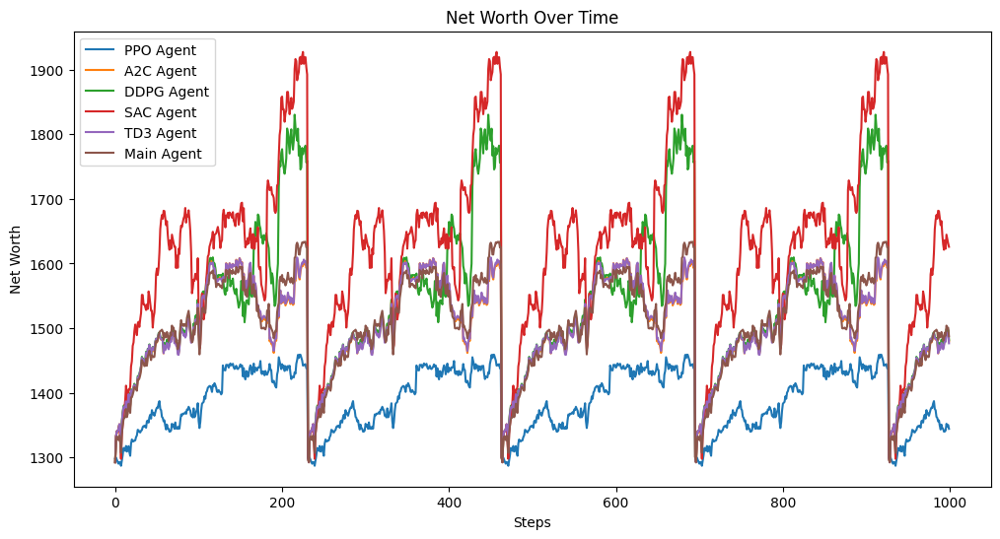

In [24]:
n_tests = 1000
agents = {
    'PPO Agent': ppo_agent,
    'A2C Agent': a2c_agent,
    'DDPG Agent': ddpg_agent,
    'SAC Agent': sac_agent,
    'TD3 Agent': td3_agent,
    'Main Agent': main_agent
}
test_and_visualize(val_env, agents, validation_set, n_steps=n_tests)

Currently Testing: PPO Agent......
<class 'float'> 26.797788979484153
<class 'float'> 25.696229934692383
<class 'float'> 12.778817489223966
<class 'float'> 13.271211624145508
<class 'float'> 2.6813402429843016
<class 'float'> 2.7538654804229736
<class 'float'> 31.300815083725695
<class 'float'> 30.603240966796875
<class 'float'> 19.77562369984131
<class 'float'> 19.900453567504883
<class 'float'> 36.5229690437946
<class 'float'> 36.92749786376953
<class 'float'> 9.848807249161702
<class 'float'> 10.147055625915527
<class 'float'> 12.835740330499856
<class 'float'> 12.844863891601562
<class 'float'> 17.079872229620808
<class 'float'> 17.181943893432617
<class 'float'> 59.63920243727395
<class 'float'> 63.26539993286133
<class 'float'> 14.284535345022775
<class 'float'> 14.526988983154297
<class 'float'> 49.808558885817654
<class 'float'> 49.98998260498047
<class 'float'> 8.026794506775577
<class 'float'> 8.533947944641113
<class 'float'> 35.389722614172626
<class 'float'> 35.66171264648

c:\Python\Lib\site-packages\stable_baselines3\common\vec_env\base_vec_env.py:244: UserWarning: You tried to call render() but no `render_mode` was passed to the env constructor.
  warnings.warn("You tried to call render() but no `render_mode` was passed to the env constructor.")


<class 'float'> 24.405362599267228
<class 'float'> 23.302093505859375
<class 'float'> 10.371553466293733
<class 'float'> 9.496184349060059
<class 'float'> 2.7580786205995755
<class 'float'> 2.616638660430908
<class 'float'> 27.828113590308536
<class 'float'> 26.1082706451416
<class 'float'> 17.909750696972136
<class 'float'> 16.50377655029297
<class 'float'> 34.98759826633815
<class 'float'> 33.37050247192383
<class 'float'> 10.074147203387618
<class 'float'> 9.517417907714844
<class 'float'> 13.082050810870989
<class 'float'> 12.79924488067627
<class 'float'> 15.06397443887726
<class 'float'> 14.434536933898926
<class 'float'> 65.84858196597365
<class 'float'> 60.94666290283203
<class 'float'> 13.085738256209533
<class 'float'> 12.600831031799316
<class 'float'> 49.36092752692691
<class 'float'> 46.63584899902344
<class 'float'> 8.160086143589464
<class 'float'> 7.641383171081543
<class 'float'> 33.76348040163613
<class 'float'> 33.43937301635742
<class 'float'> 14.068196362222595
<cl

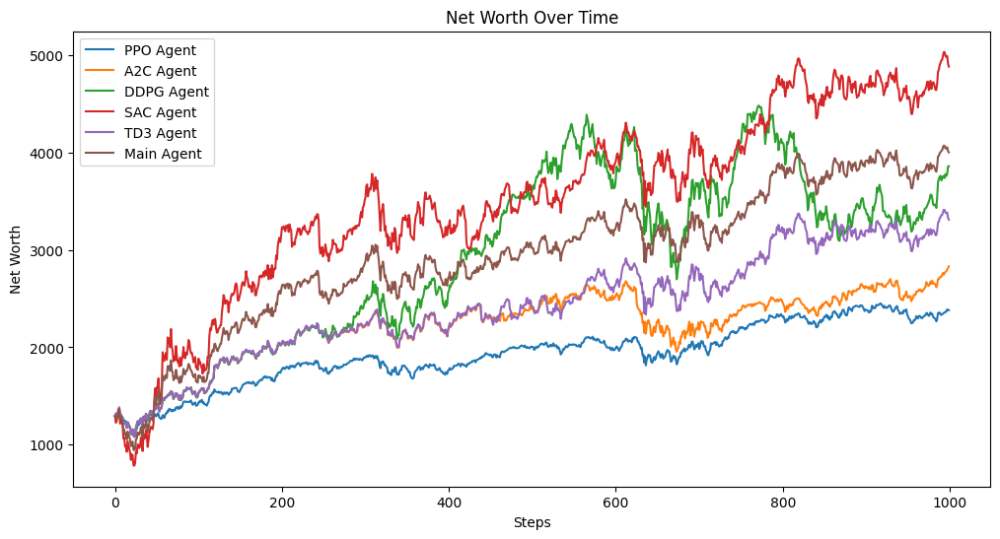

Currently Testing: PPO Agent......
<class 'float'> 109.64117431640625
<class 'float'> 109.64117431640625
<class 'float'> 68.71858885847791
<class 'float'> 68.63811492919922
<class 'float'> 29.378679387702707
<class 'float'> 29.776470184326172
<class 'float'> 152.2832806219429
<class 'float'> 152.023681640625
<class 'float'> 79.63561258581268
<class 'float'> 79.05378723144531
<class 'float'> 78.36281622199317
<class 'float'> 78.22187805175781
<class 'float'> 24.098425859858075
<class 'float'> 23.825023651123047
<class 'float'> 32.230555430803044
<class 'float'> 32.028724670410156
<class 'float'> 104.72441894081092
<class 'float'> 105.28252410888672
<class 'float'> 193.71009892685464
<class 'float'> 193.8445587158203
<class 'float'> 113.55664831001368
<class 'float'> 113.37516784667969
<class 'float'> 115.75107163742273
<class 'float'> 115.28145599365234
<class 'float'> 30.059378213215776
<class 'float'> 29.814462661743164
<class 'float'> 89.64715722944983
<class 'float'> 90.244911193847

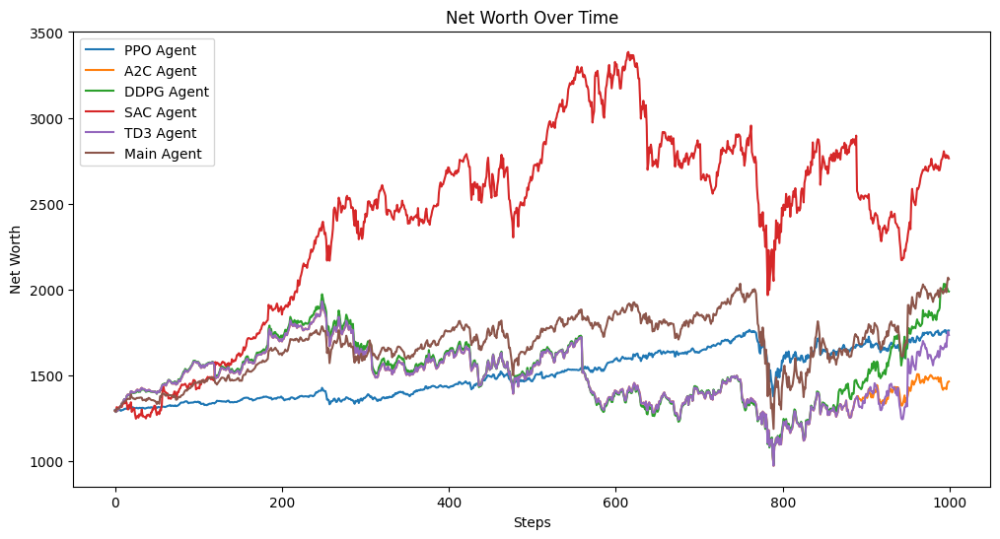

In [23]:
n_tests = 1000
agents = {
    'PPO Agent': ppo_agent,
    'A2C Agent': a2c_agent,
    'DDPG Agent': ddpg_agent,
    'SAC Agent': sac_agent,
    'TD3 Agent': td3_agent,
    'Main Agent': main_agent
}
test_and_visualize(train_env, agents, training_set, n_steps=n_tests)
test_env = DummyVecEnv([lambda: TradingEnv(test_set)])

test_and_visualize(test_env , agents, test_set, n_steps=n_tests)

## This indicates that our model handeled the Covid Pandemic Drop Very Well